In [0]:
%tensorflow_version 2.x
import tensorflow as tf
from tensorflow.keras.models import Sequential, Model, load_model
from  tensorflow.keras.layers import Input, Conv2D, MaxPool2D, Flatten, Dense, Conv2DTranspose, Reshape, UpSampling2D, BatchNormalization
from tensorflow.keras.optimizers import Adam

from PIL import Image
import os
import cv2
%matplotlib inline
from matplotlib import pyplot as plt
import numpy as np

TensorFlow 2.x selected.


In [0]:
from google.colab import drive
drive.mount('/content/drive')

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&response_type=code&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly

Enter your authorization code:
··········
Mounted at /content/drive


In [0]:
!unzip /content/drive/My\ Drive/CV_project/img_align_celeba_mustache_png.zip

Archive:  /content/drive/My Drive/CV_project/img_align_celeba_mustache_png.zip
   creating: img_align_celeba_mustache_png/
  inflating: img_align_celeba_mustache_png/000314.png  
  inflating: img_align_celeba_mustache_png/000797.png  
  inflating: img_align_celeba_mustache_png/001022.png  
  inflating: img_align_celeba_mustache_png/001257.png  
  inflating: img_align_celeba_mustache_png/001474.png  
  inflating: img_align_celeba_mustache_png/002227.png  
  inflating: img_align_celeba_mustache_png/002259.png  
  inflating: img_align_celeba_mustache_png/002281.png  
  inflating: img_align_celeba_mustache_png/002477.png  
  inflating: img_align_celeba_mustache_png/002574.png  
  inflating: img_align_celeba_mustache_png/002644.png  
  inflating: img_align_celeba_mustache_png/002768.png  
  inflating: img_align_celeba_mustache_png/002898.png  
  inflating: img_align_celeba_mustache_png/003035.png  
  inflating: img_align_celeba_mustache_png/003079.png  
  inflating: img_align_celeba_mustach

In [0]:
# Encoder
#1st layer
input = Input((227,227,3))
x = Conv2D(filters = 96, kernel_size=(11,11), strides = (4,4), activation='relu')(input)
x = MaxPool2D(pool_size=(3,3), strides=(2,2))(x)
#2nd layer
x = Conv2D(filters = 256, kernel_size=(5,5),strides = (1,1), padding='same', activation='relu')(x)
x = MaxPool2D(pool_size=(3,3), strides=(2,2),)(x)
#3rd layer
x = Conv2D(filters = 384, kernel_size=(3,3),strides = (1,1),padding='same', activation='relu')(x)
#4th layer
x = Conv2D(filters = 384, kernel_size=(3,3),strides = (1,1),padding='same', activation='relu')(x)
#5th layer
x = Conv2D(filters = 256, kernel_size=(3,3),strides = (1,1),padding='same', activation='relu')(x)
x = MaxPool2D(pool_size=(3,3), strides=(2,2))(x)

# Channel-wise Fully Connected	
x = Flatten()(x)
x = Dense(9216)(x)
x  = Reshape((6,6,256))(x)

# Decoder
x = Conv2DTranspose(filters = 128, kernel_size=(5,5), strides = 2, padding='same')(x)
x = BatchNormalization(axis=-1)(x)
x = Conv2DTranspose(filters = 64, kernel_size=(5,5), strides = 2, padding='same')(x)
x = BatchNormalization(axis=-1)(x)
x = Conv2DTranspose(filters = 64, kernel_size=(5,5), strides = 2, padding='same' )(x)
x = BatchNormalization(axis=-1)(x)
x = Conv2DTranspose(filters = 32, kernel_size=(5,5), strides = 2, padding='same',)(x)
x = BatchNormalization(axis=-1)(x)
x = Conv2DTranspose(filters = 3, kernel_size=(5,5), strides = 2, padding='same' )(x)
x = BatchNormalization(axis=-1)(x)
x = tf.image.resize(x, size=(227,227))



Generator = Model(inputs=input, outputs=x)



In [0]:
input_discriminator = Input((227,227,3))
dis = Conv2D(filters = 96, kernel_size=(4,4), strides = (2,2), activation='relu')(input_discriminator)
dis = Conv2D(filters = 96, kernel_size=(4,4), strides = (2,2), activation='relu')(dis)
dis = Conv2D(filters = 96, kernel_size=(4,4), strides = (2,2), activation='relu')(dis)
dis = Conv2D(filters = 128, kernel_size=(4,4), strides = (1,1), activation='relu')(dis)
dis = Conv2D(filters = 256, kernel_size=(4,4), strides = (2,2), activation='relu')(dis)
dis = Conv2D(filters = 512, kernel_size=(4,4), strides = (2,2), activation='relu')(dis)
dis = Flatten()(dis)
dis = Dense(1, activation='sigmoid')(dis)
Discriminator = Model(inputs=input_discriminator, outputs=dis)


In [0]:
optimizer = Adam(0.0002, 0.5)

Discriminator.compile(loss='binary_crossentropy', optimizer=optimizer, metrics=['accuracy'])
Discriminator.trainable = False

masked_img = Input(shape=(227,227,3))
gen_masked = Generator(masked_img)


# The discriminator takes generated images as input and determines
# if it is generated or if it is a real image
valid = Discriminator(gen_masked)

# The combined model  (stacked generator and discriminator)
# Trains generator to fool discriminator
combined_model = Model(masked_img , [gen_masked, valid])
combined_model.compile(loss=['mse', 'binary_crossentropy'], loss_weights=[0.999, 0.001], optimizer=optimizer)



In [0]:
class DataStorage:
    def __init__(self, images_path, batch_size=8, mode='test', target_size=(227, 227), mask_size=(64, 64)):
      self.batch_size = batch_size
      self.target_size = target_size
      self.mask_size = mask_size
      self.mode = mode
      
      self.filepaths = []
      for filepath in os.listdir(images_path):
        if filepath.endswith('.png'):
          self.filepaths.append(os.path.join(images_path, filepath))

      self.mouth_positions = dict()
      with open('mouth_positions.txt', 'r') as f:
        for line in f:
          s = line.strip().split()
          for i in range(1, len(s)):
            s[i] = int(s[i])
          # filename lefteye_x lefteye_y righteye_x righteye_y nose_x nose_y leftmouth_x leftmouth_y rightmouth_x rightmouth_y
          filename = '{}.png'.format(s[0].split('.')[0])
          leftmouth_x, leftmouth_y, rightmouth_x, rightmouth_y = s[-4], s[-3], s[-2], s[-1]
          self.mouth_positions[os.path.join(images_path, filename)] = (leftmouth_x, leftmouth_y, rightmouth_x, rightmouth_y)

      self.batches_count = (len(self.filepaths) + batch_size - 1) // batch_size
      self.next_batch_start_index = 0

    def get_batches_count(self):
      return self.batches_count

    def get_next_batch(self):
      masked_images = []
      masked_parts = []
      y_ranges = []
      x_ranges = []
      images = []
      for imagepath in self.filepaths[self.next_batch_start_index : min(self.next_batch_start_index + self.batch_size, len(self.filepaths))]:
        if self.mode == 'train':
          img, mi, mp, y_range, x_range = self.make_random_mask(imagepath)
        elif self.mode == 'test':
          img, mi, mp, y_range, x_range = self.make_mustache_mask(imagepath)
        else:
          img, mi, mp, y_range, x_range = self.make_center_mask(imagepath)
        masked_images.append(mi)
        masked_parts.append(mp)
        y_ranges.append(y_range)
        x_ranges.append(x_range)
        images.append(img)
        self.next_batch_start_index = (self.next_batch_start_index + self.batch_size) % len(self.filepaths)
      return images, masked_images, masked_parts, y_ranges, x_ranges

    def make_random_mask(self, filepath):
      image = cv2.imread(filepath)
      image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

      leftmouth_x, leftmouth_y, rightmouth_x, rightmouth_y = self.mouth_positions[filepath]

      x_mouth_center = (leftmouth_x + rightmouth_x) // 2
      y_mouth_center = (leftmouth_y + rightmouth_y) // 2

      mask_size = self.mask_size

      dy = np.random.randint(-y_mouth_center, image.shape[0] - y_mouth_center - mask_size[0])
      dy = max(-mask_size[0], dy)
      dy = min(mask_size[0], dy)

      dx = np.random.randint(-x_mouth_center, image.shape[1] - x_mouth_center - mask_size[1])
      dx = max(-mask_size[1], dx)
      dx = min(mask_size[1], dx)

      y_range = (y_mouth_center + dy, y_mouth_center + dy + mask_size[0])
      x_range = (x_mouth_center + dx, x_mouth_center + dx + mask_size[1])

      masked_image = image.copy()

      scaleY = self.target_size[0] / image.shape[0]
      scaleX = self.target_size[1] / image.shape[1]

      y_range = (int(y_range[0] * scaleY), int(y_range[1] * scaleY))
      x_range = (int(x_range[0] * scaleX), int(x_range[1] * scaleX))

      masked_image = cv2.resize(masked_image, dsize=self.target_size, interpolation=cv2.INTER_CUBIC)

      masked_image[y_range[0]:y_range[1], x_range[0]:x_range[1], :] = 255

      masked_image = masked_image / 255
      masked_image = (masked_image - 0.5) / 0.5

      masked_part = image.copy()
      masked_part = cv2.resize(masked_part, dsize=self.target_size, interpolation=cv2.INTER_CUBIC)

      masked_part[0:y_range[0], :, :] = 255
      masked_part[y_range[1]:, :, :] = 255
      masked_part[:, 0:x_range[0], :] = 255
      masked_part[:, x_range[1]:, :] = 255

      masked_part = masked_part / 255
      masked_part = (masked_part - 0.5) / 0.5

      return cv2.resize(image.copy(), dsize=self.target_size, interpolation=cv2.INTER_CUBIC), masked_image, masked_part, y_range, x_range

    def make_mustache_mask(self, filepath):
      image = cv2.imread(filepath)
      image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

      leftmouth_x, leftmouth_y, rightmouth_x, rightmouth_y = self.mouth_positions[filepath]
      hor_padding = 10
      ver_padding = 10

      x_left, x_right = min(leftmouth_x, rightmouth_x), max(leftmouth_x, rightmouth_x)
      x_left -= hor_padding
      x_right += hor_padding

      y_upper, y_lower = min(leftmouth_y, rightmouth_y), max(leftmouth_y, rightmouth_y)
      y_upper -= ver_padding
      y_lower += ver_padding

      scaleY = self.target_size[0] / image.shape[0]
      scaleX = self.target_size[1] / image.shape[1]

      y_range = (int(y_upper * scaleY), int(y_lower * scaleY))
      x_range = (int(x_left * scaleX), int(x_right * scaleX))

      masked_image = image.copy()
      masked_image = cv2.resize(masked_image, dsize=self.target_size, interpolation=cv2.INTER_CUBIC)

      masked_image[y_range[0]:y_range[1], x_range[0]:x_range[1], :] = 255

      masked_image = masked_image / 255
      masked_image = (masked_image - 0.5) / 0.5


      masked_part = image.copy()
      masked_part = cv2.resize(masked_part, dsize=self.target_size, interpolation=cv2.INTER_CUBIC)

      masked_part[0:y_range[0], :, :] = 255
      masked_part[y_range[1]:, :, :] = 255
      masked_part[:, 0:x_range[0], :] = 255
      masked_part[:, x_range[1]:, :] = 255

      masked_part = masked_part / 255
      masked_part = (masked_part - 0.5) / 0.5

      return cv2.resize(image.copy(), dsize=self.target_size, interpolation=cv2.INTER_CUBIC), masked_image, masked_part, y_range, x_range

    def make_center_mask(self, filepath):
      image = cv2.imread(filepath)
      image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
      image = cv2.resize(image, dsize=self.target_size, interpolation=cv2.INTER_CUBIC)

      masked_image = image.copy()
      y_upper, x_left = image.shape[0] // 2 - self.mask_size[0] // 2, image.shape[1] // 2 - self.mask_size[1] // 2

      y_range = (y_upper, y_upper + self.mask_size[0])
      x_range = (x_left, x_left + self.mask_size[1])

      masked_image[y_range[0]:y_range[1], x_range[0]:x_range[1], :] = 255

      masked_image = masked_image / 255
      masked_image = (masked_image - 0.5) / 0.5

      masked_part = image.copy()
      masked_part = cv2.resize(masked_part, dsize=self.target_size, interpolation=cv2.INTER_CUBIC)

      masked_part[0:y_range[0], :, :] = 255
      masked_part[y_range[1]:, :, :] = 255
      masked_part[:, 0:x_range[0], :] = 255
      masked_part[:, x_range[1]:, :] = 255

      masked_part = masked_part / 255
      masked_part = (masked_part - 0.5) / 0.5

      return cv2.resize(image.copy(), dsize=self.target_size, interpolation=cv2.INTER_CUBIC), masked_image, masked_part, y_range, x_range


In [0]:
def showInRow(list_of_images, titles = None):
  count = len(list_of_images)
  for idx in range(count):
    subplot = plt.subplot(1, count, idx+1)
    if titles is not None:
      subplot.set_title(titles[idx])
      
    img = list_of_images[idx]
    
    subplot.imshow(img)
  plt.show()

Model: "model_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_3 (InputLayer)         [(None, 227, 227, 3)]     0         
_________________________________________________________________
model (Model)                (None, 227, 227, 3)       89872527  
_________________________________________________________________
model_1 (Model)              (None, 1)                 3126945   
Total params: 92,999,472
Trainable params: 89,871,945
Non-trainable params: 3,127,527
_________________________________________________________________
Epoch:0 Batches:1/1053 [D loss: 7.666619, acc: 50.00%] [G loss: 0.177301, mse: 0.162130]
Epoch:0 Batches:2/1053 [D loss: 7.666619, acc: 50.00%] [G loss: 0.182371, mse: 0.167205]
Epoch:0 Batches:3/1053 [D loss: 7.666619, acc: 50.00%] [G loss: 0.191235, mse: 0.176078]
Epoch:0 Batches:4/1053 [D loss: 7.666619, acc: 50.00%] [G loss: 0.177449, mse: 0.162278]
Epoch:0 Batch

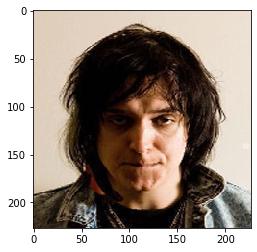

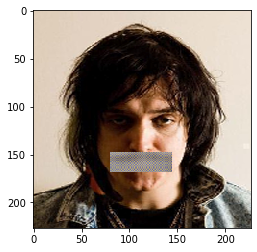

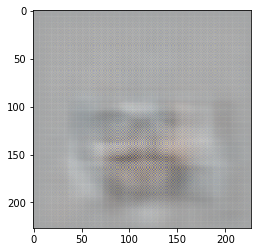

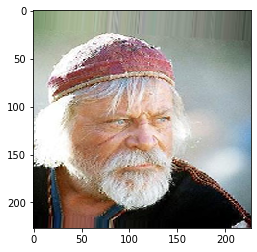

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


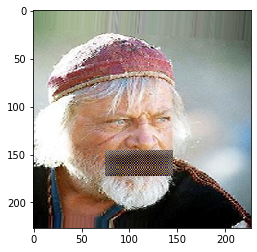

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


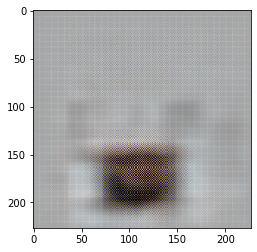

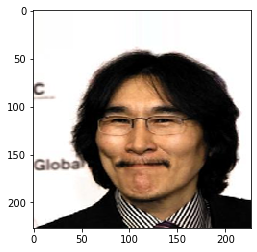

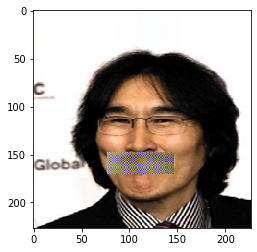

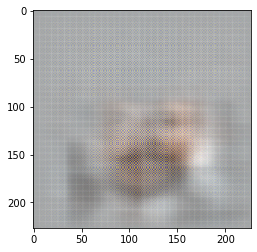

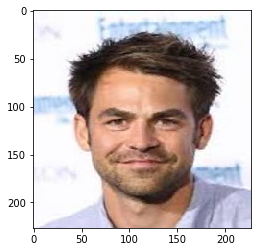

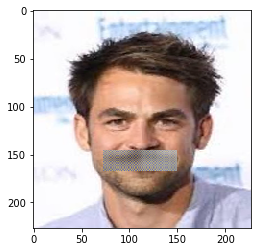

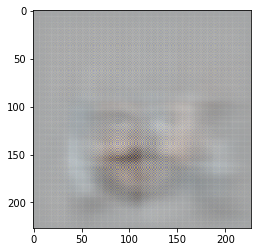

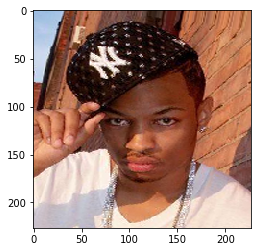

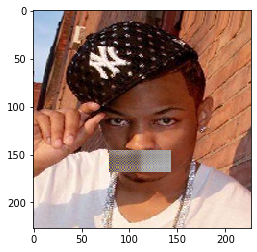

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


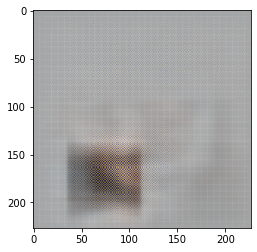

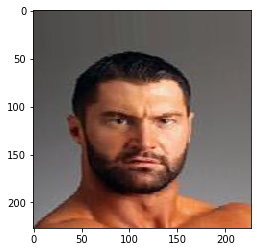

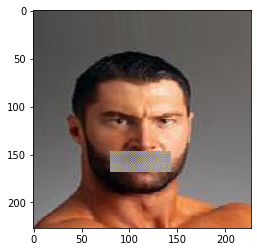

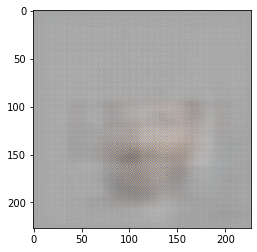

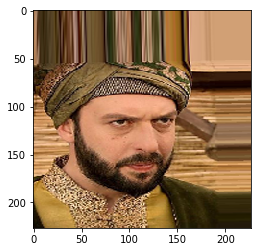

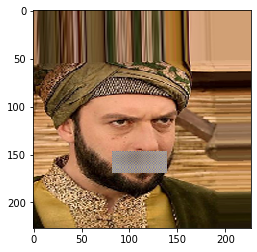

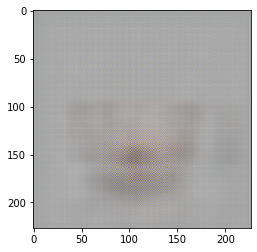

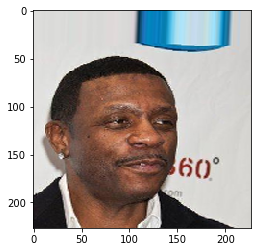

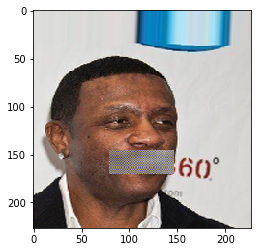

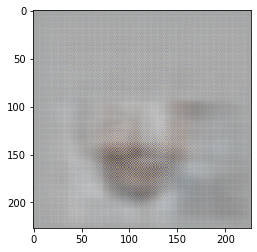

Epoch:1 Batches:1/1053 [D loss: 7.666619, acc: 50.00%] [G loss: 0.090659, mse: 0.075401]
Epoch:1 Batches:2/1053 [D loss: 7.666619, acc: 50.00%] [G loss: 0.077458, mse: 0.062187]
Epoch:1 Batches:3/1053 [D loss: 7.666619, acc: 50.00%] [G loss: 0.086528, mse: 0.071266]
Epoch:1 Batches:4/1053 [D loss: 7.666619, acc: 50.00%] [G loss: 0.091628, mse: 0.076372]
Epoch:1 Batches:5/1053 [D loss: 7.666619, acc: 50.00%] [G loss: 0.085100, mse: 0.069837]
Epoch:1 Batches:6/1053 [D loss: 7.666619, acc: 50.00%] [G loss: 0.088929, mse: 0.073670]
Epoch:1 Batches:7/1053 [D loss: 7.666619, acc: 50.00%] [G loss: 0.088510, mse: 0.073250]
Epoch:1 Batches:8/1053 [D loss: 7.666619, acc: 50.00%] [G loss: 0.095808, mse: 0.080555]
Epoch:1 Batches:9/1053 [D loss: 7.666619, acc: 50.00%] [G loss: 0.085009, mse: 0.069746]
Epoch:1 Batches:10/1053 [D loss: 7.666619, acc: 50.00%] [G loss: 0.083072, mse: 0.067806]
Epoch:1 Batches:11/1053 [D loss: 7.666619, acc: 50.00%] [G loss: 0.093471, mse: 0.078216]
Epoch:1 Batches:12/

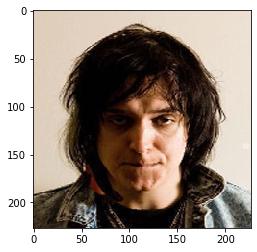

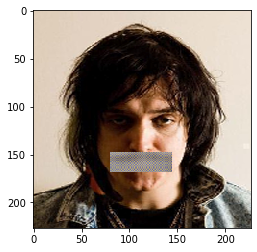

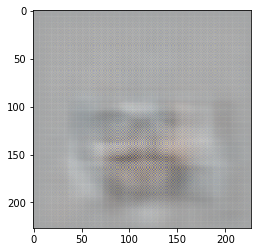

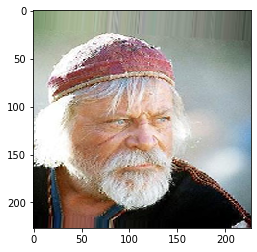

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


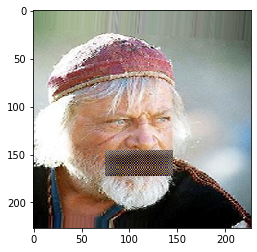

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


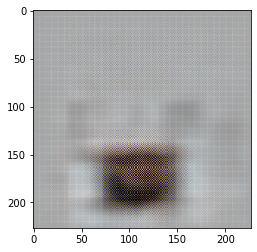

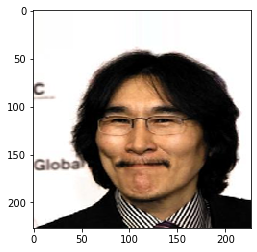

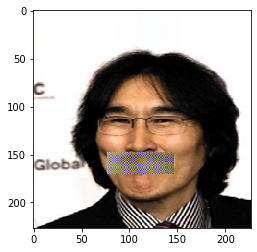

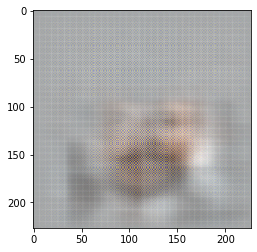

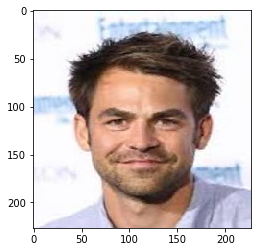

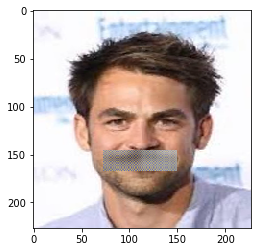

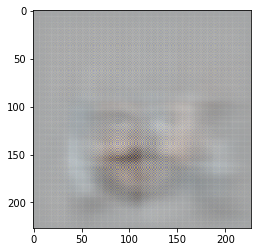

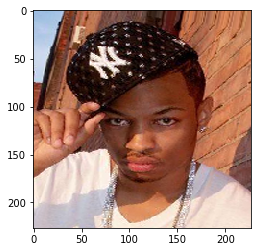

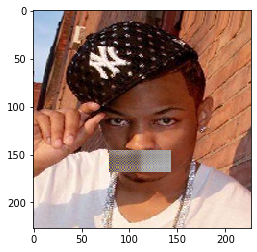

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


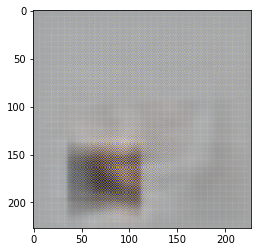

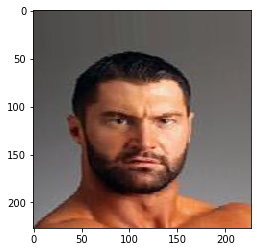

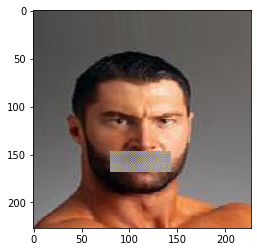

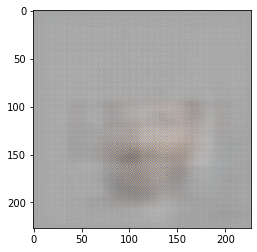

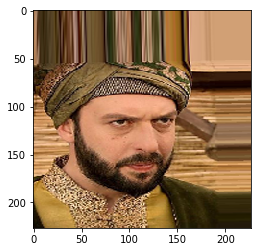

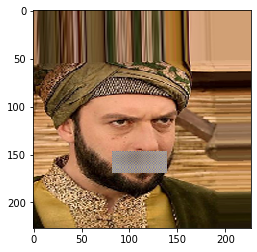

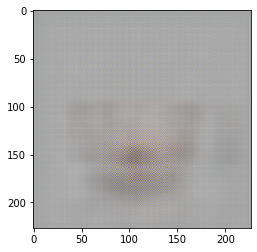

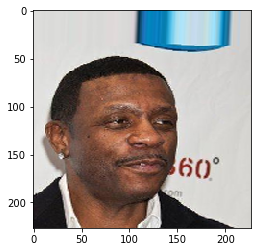

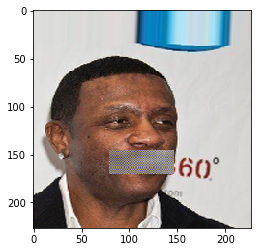

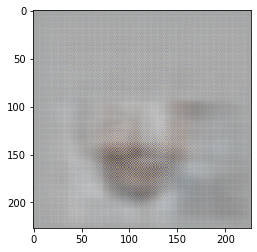

Epoch:2 Batches:1/1053 [D loss: 7.666619, acc: 50.00%] [G loss: 0.045336, mse: 0.030033]
Epoch:2 Batches:2/1053 [D loss: 7.666619, acc: 50.00%] [G loss: 0.041571, mse: 0.026264]
Epoch:2 Batches:3/1053 [D loss: 7.666619, acc: 50.00%] [G loss: 0.050981, mse: 0.035683]
Epoch:2 Batches:4/1053 [D loss: 7.666619, acc: 50.00%] [G loss: 0.039051, mse: 0.023741]
Epoch:2 Batches:5/1053 [D loss: 7.666619, acc: 50.00%] [G loss: 0.042324, mse: 0.027018]
Epoch:2 Batches:6/1053 [D loss: 7.666619, acc: 50.00%] [G loss: 0.041770, mse: 0.026464]
Epoch:2 Batches:7/1053 [D loss: 7.666619, acc: 50.00%] [G loss: 0.046328, mse: 0.031026]
Epoch:2 Batches:8/1053 [D loss: 7.666619, acc: 50.00%] [G loss: 0.041080, mse: 0.025773]
Epoch:2 Batches:9/1053 [D loss: 7.666619, acc: 50.00%] [G loss: 0.041923, mse: 0.026616]
Epoch:2 Batches:10/1053 [D loss: 7.666619, acc: 50.00%] [G loss: 0.040984, mse: 0.025676]
Epoch:2 Batches:11/1053 [D loss: 7.666619, acc: 50.00%] [G loss: 0.042821, mse: 0.027515]
Epoch:2 Batches:12/

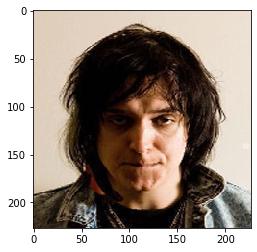

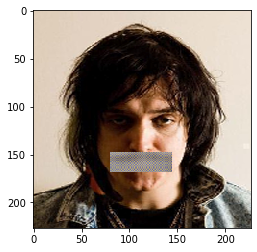

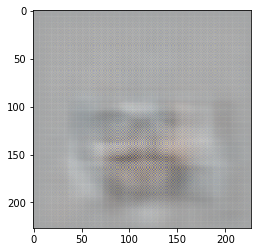

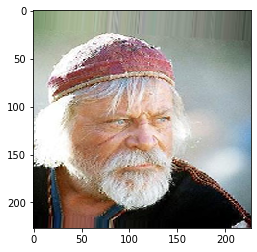

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


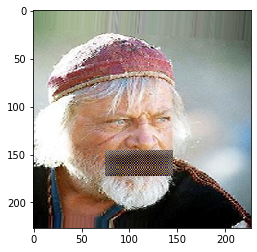

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


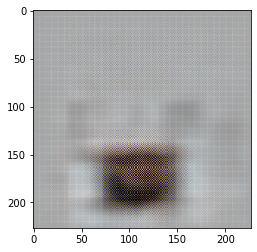

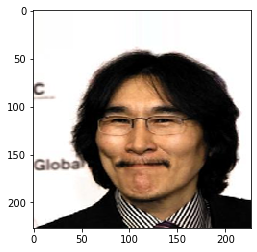

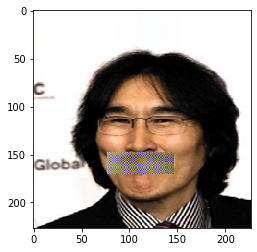

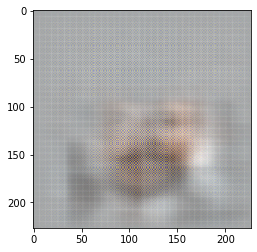

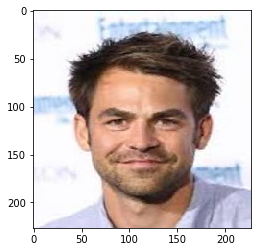

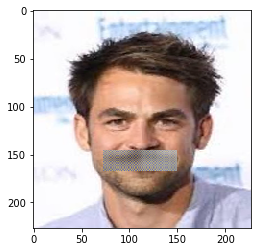

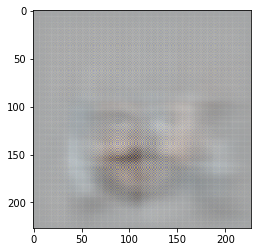

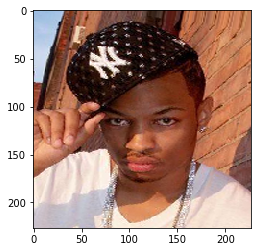

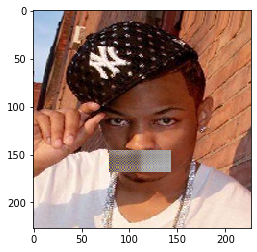

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


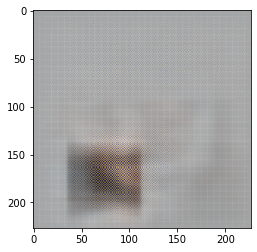

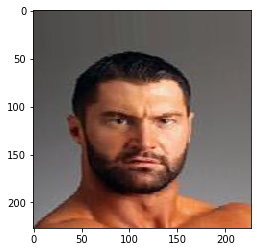

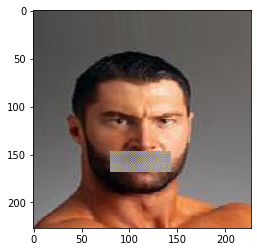

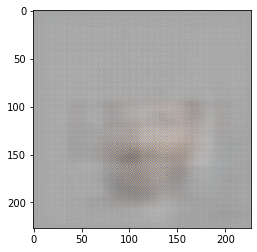

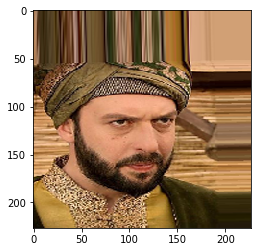

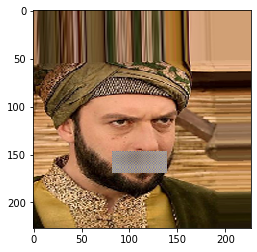

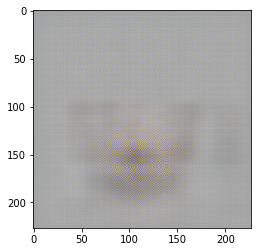

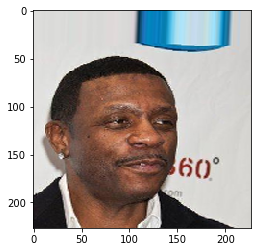

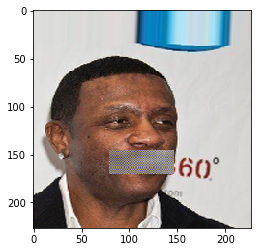

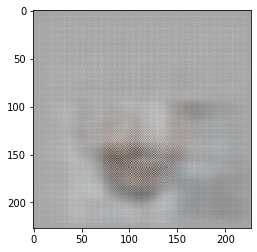

Epoch:3 Batches:1/1053 [D loss: 7.666619, acc: 50.00%] [G loss: 0.028673, mse: 0.013353]
Epoch:3 Batches:2/1053 [D loss: 7.666619, acc: 50.00%] [G loss: 0.030209, mse: 0.014890]
Epoch:3 Batches:3/1053 [D loss: 7.666619, acc: 50.00%] [G loss: 0.035750, mse: 0.020438]
Epoch:3 Batches:4/1053 [D loss: 7.666619, acc: 50.00%] [G loss: 0.031617, mse: 0.016300]
Epoch:3 Batches:5/1053 [D loss: 7.666619, acc: 50.00%] [G loss: 0.030500, mse: 0.015182]
Epoch:3 Batches:6/1053 [D loss: 7.666619, acc: 50.00%] [G loss: 0.029612, mse: 0.014293]
Epoch:3 Batches:7/1053 [D loss: 7.666619, acc: 50.00%] [G loss: 0.030424, mse: 0.015106]
Epoch:3 Batches:8/1053 [D loss: 7.666619, acc: 50.00%] [G loss: 0.032365, mse: 0.017049]
Epoch:3 Batches:9/1053 [D loss: 7.666619, acc: 50.00%] [G loss: 0.030691, mse: 0.015373]
Epoch:3 Batches:10/1053 [D loss: 7.666619, acc: 50.00%] [G loss: 0.030440, mse: 0.015122]
Epoch:3 Batches:11/1053 [D loss: 7.666619, acc: 50.00%] [G loss: 0.029656, mse: 0.014337]
Epoch:3 Batches:12/

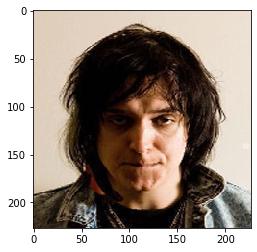

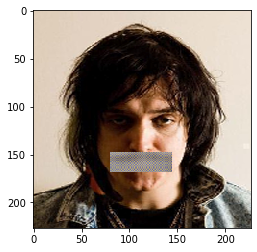

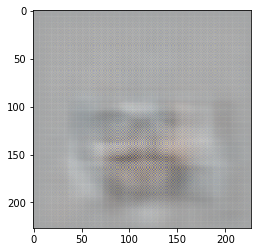

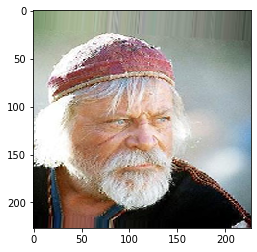

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


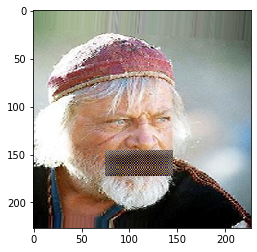

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


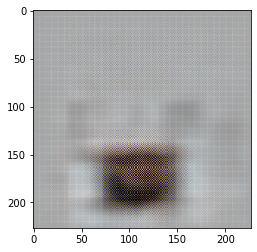

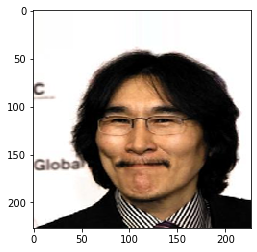

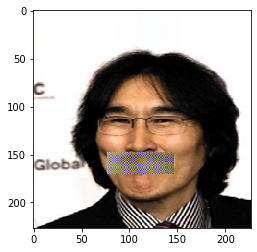

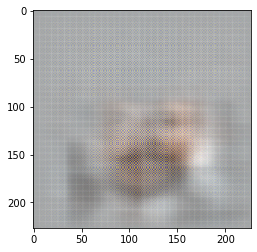

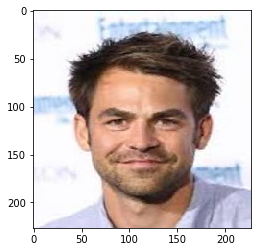

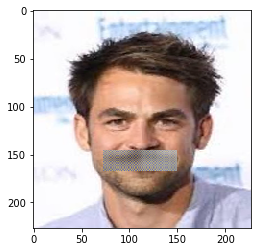

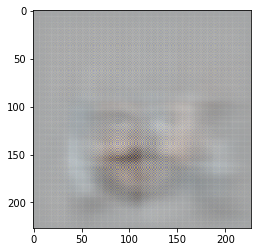

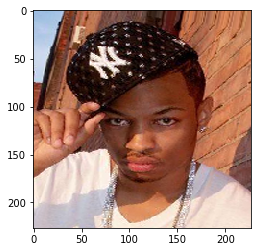

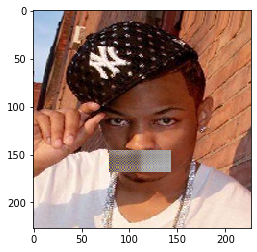

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


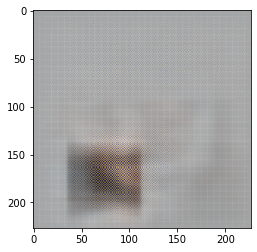

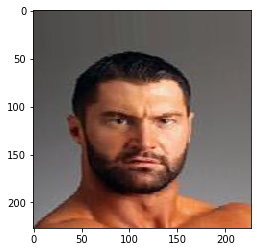

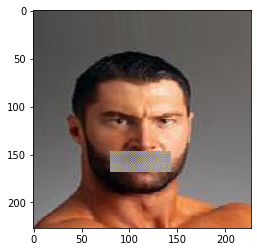

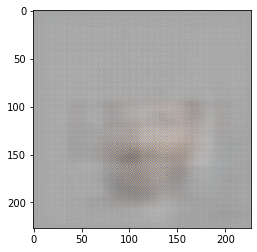

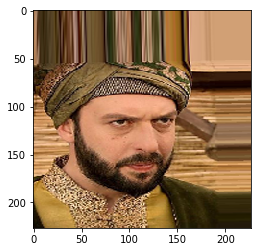

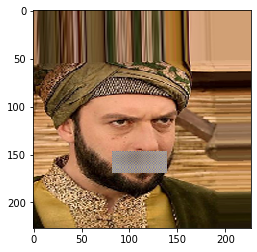

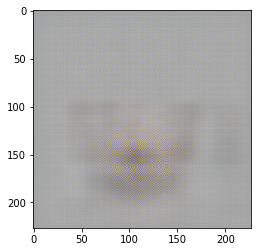

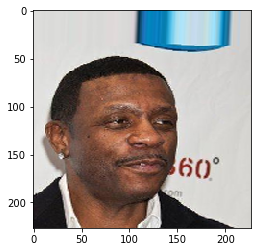

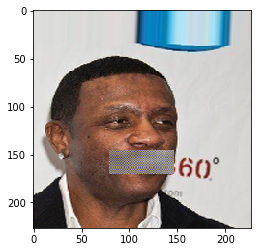

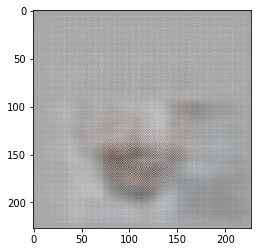

Epoch:4 Batches:1/1053 [D loss: 7.666619, acc: 50.00%] [G loss: 0.027607, mse: 0.012286]
Epoch:4 Batches:2/1053 [D loss: 7.666619, acc: 50.00%] [G loss: 0.030955, mse: 0.015637]
Epoch:4 Batches:3/1053 [D loss: 7.666619, acc: 50.00%] [G loss: 0.026502, mse: 0.011180]
Epoch:4 Batches:4/1053 [D loss: 7.666619, acc: 50.00%] [G loss: 0.030191, mse: 0.014872]
Epoch:4 Batches:5/1053 [D loss: 7.666619, acc: 50.00%] [G loss: 0.029130, mse: 0.013811]
Epoch:4 Batches:6/1053 [D loss: 7.666619, acc: 50.00%] [G loss: 0.026598, mse: 0.011276]
Epoch:4 Batches:7/1053 [D loss: 7.666619, acc: 50.00%] [G loss: 0.028315, mse: 0.012995]
Epoch:4 Batches:8/1053 [D loss: 7.666619, acc: 50.00%] [G loss: 0.034907, mse: 0.019594]
Epoch:4 Batches:9/1053 [D loss: 7.666619, acc: 50.00%] [G loss: 0.028452, mse: 0.013132]
Epoch:4 Batches:10/1053 [D loss: 7.666619, acc: 50.00%] [G loss: 0.029518, mse: 0.014199]
Epoch:4 Batches:11/1053 [D loss: 7.666619, acc: 50.00%] [G loss: 0.027777, mse: 0.012456]
Epoch:4 Batches:12/

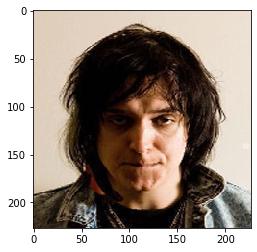

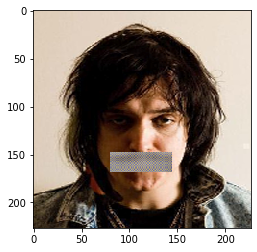

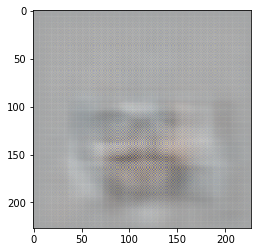

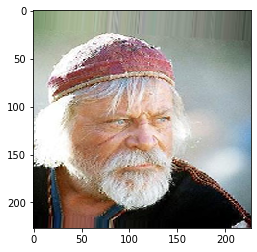

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


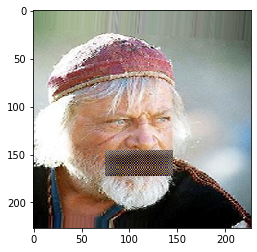

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


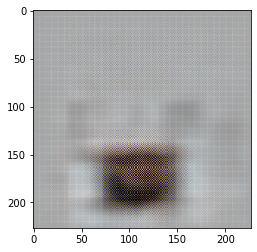

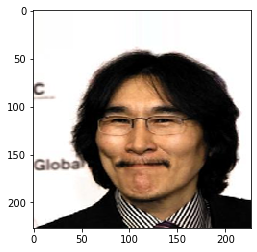

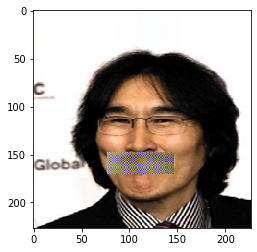

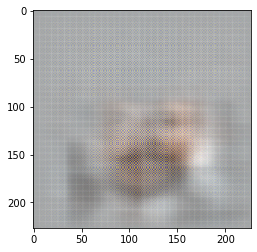

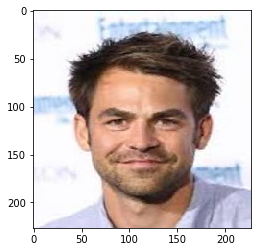

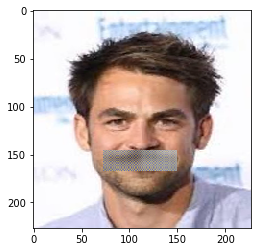

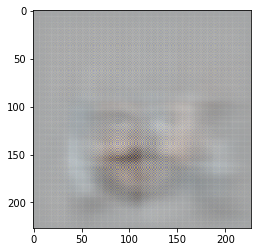

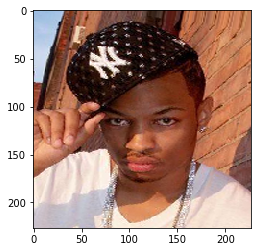

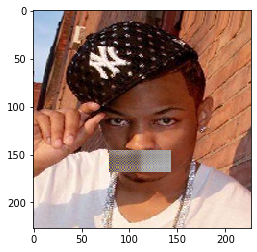

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


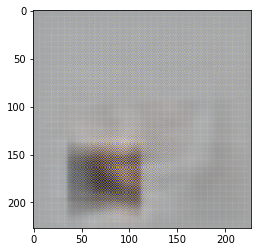

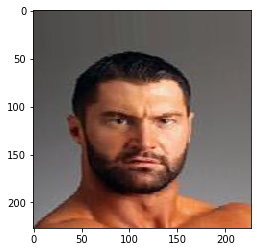

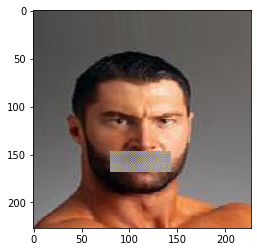

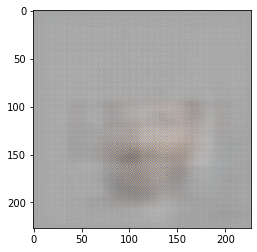

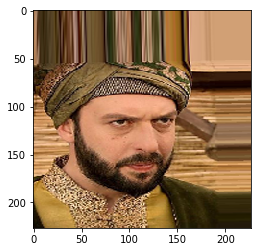

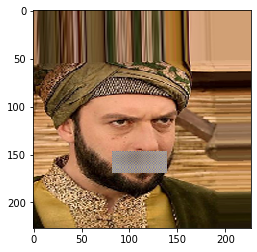

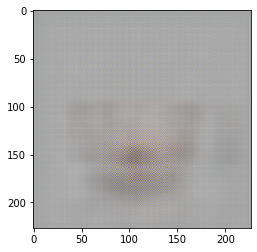

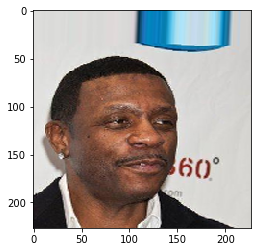

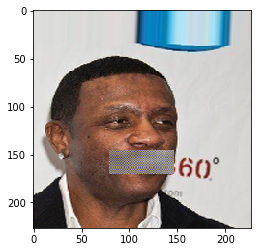

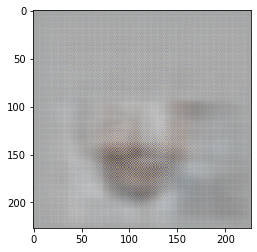

Epoch:5 Batches:1/1053 [D loss: 7.666619, acc: 50.00%] [G loss: 0.026269, mse: 0.010946]
Epoch:5 Batches:2/1053 [D loss: 7.666619, acc: 50.00%] [G loss: 0.031691, mse: 0.016375]
Epoch:5 Batches:3/1053 [D loss: 7.666619, acc: 50.00%] [G loss: 0.032205, mse: 0.016888]
Epoch:5 Batches:4/1053 [D loss: 7.666619, acc: 50.00%] [G loss: 0.029529, mse: 0.014210]
Epoch:5 Batches:5/1053 [D loss: 7.666619, acc: 50.00%] [G loss: 0.024050, mse: 0.008725]
Epoch:5 Batches:6/1053 [D loss: 7.666619, acc: 50.00%] [G loss: 0.031496, mse: 0.016179]
Epoch:5 Batches:7/1053 [D loss: 7.666619, acc: 50.00%] [G loss: 0.029086, mse: 0.013766]
Epoch:5 Batches:8/1053 [D loss: 7.666619, acc: 50.00%] [G loss: 0.029274, mse: 0.013955]
Epoch:5 Batches:9/1053 [D loss: 7.666619, acc: 50.00%] [G loss: 0.026344, mse: 0.011022]
Epoch:5 Batches:10/1053 [D loss: 7.666619, acc: 50.00%] [G loss: 0.029566, mse: 0.014247]
Epoch:5 Batches:11/1053 [D loss: 7.666619, acc: 50.00%] [G loss: 0.032997, mse: 0.017682]
Epoch:5 Batches:12/

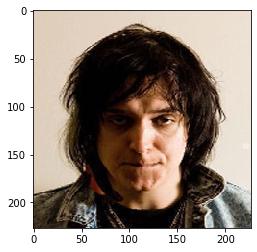

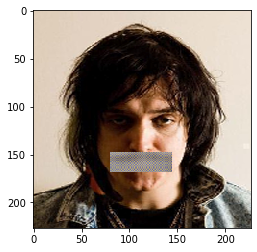

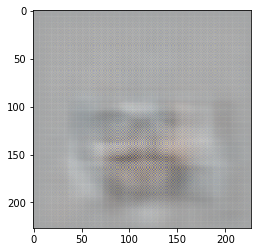

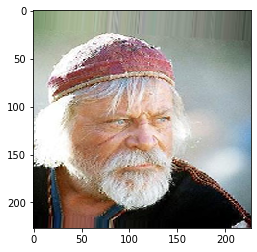

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


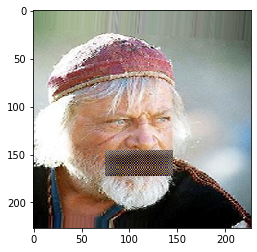

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


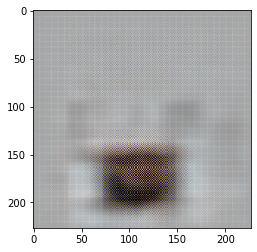

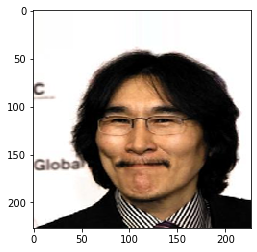

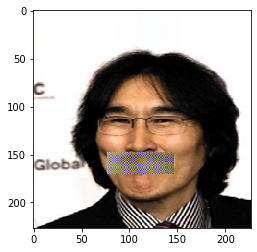

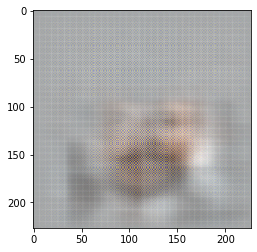

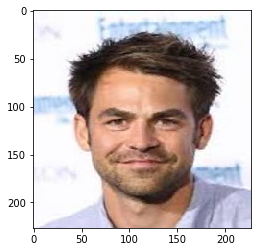

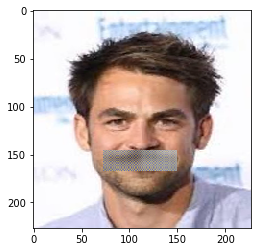

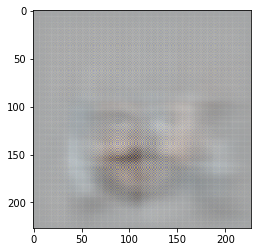

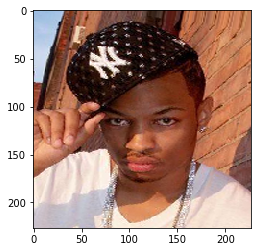

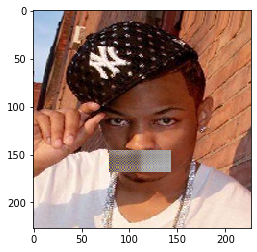

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


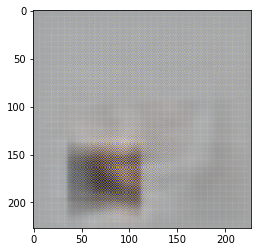

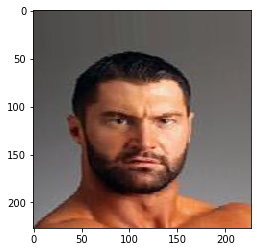

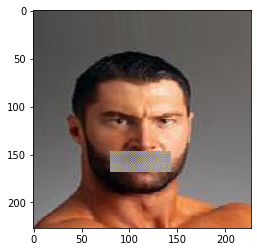

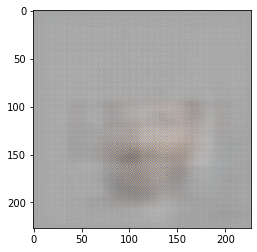

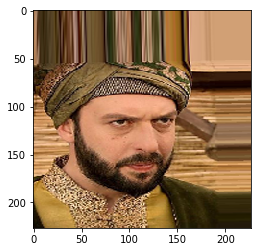

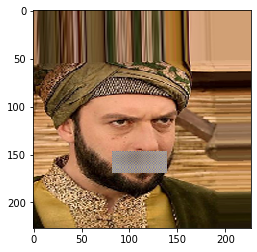

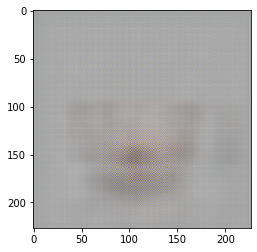

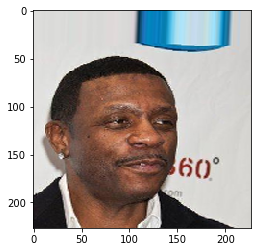

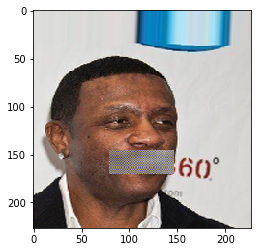

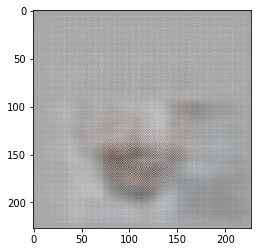

Epoch:6 Batches:1/1053 [D loss: 7.666619, acc: 50.00%] [G loss: 0.032177, mse: 0.016860]
Epoch:6 Batches:2/1053 [D loss: 7.666619, acc: 50.00%] [G loss: 0.025712, mse: 0.010389]
Epoch:6 Batches:3/1053 [D loss: 7.666619, acc: 50.00%] [G loss: 0.028791, mse: 0.013472]
Epoch:6 Batches:4/1053 [D loss: 7.666619, acc: 50.00%] [G loss: 0.026667, mse: 0.011345]
Epoch:6 Batches:5/1053 [D loss: 7.666619, acc: 50.00%] [G loss: 0.028311, mse: 0.012991]
Epoch:6 Batches:6/1053 [D loss: 7.666619, acc: 50.00%] [G loss: 0.029563, mse: 0.014244]
Epoch:6 Batches:7/1053 [D loss: 7.666619, acc: 50.00%] [G loss: 0.031269, mse: 0.015951]
Epoch:6 Batches:8/1053 [D loss: 7.666619, acc: 50.00%] [G loss: 0.024988, mse: 0.009664]
Epoch:6 Batches:9/1053 [D loss: 7.666619, acc: 50.00%] [G loss: 0.033382, mse: 0.018067]
Epoch:6 Batches:10/1053 [D loss: 7.666619, acc: 50.00%] [G loss: 0.026595, mse: 0.011273]
Epoch:6 Batches:11/1053 [D loss: 7.666619, acc: 50.00%] [G loss: 0.027762, mse: 0.012441]
Epoch:6 Batches:12/

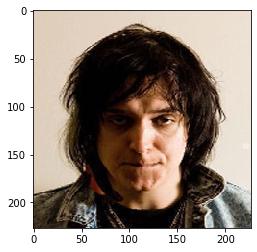

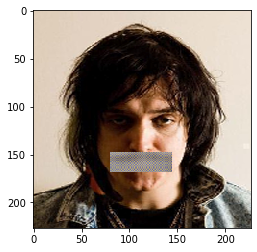

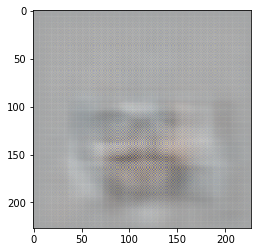

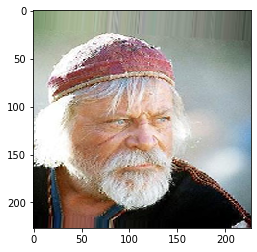

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


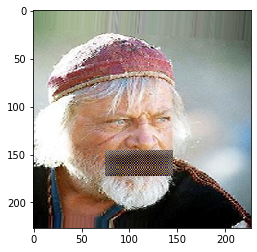

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


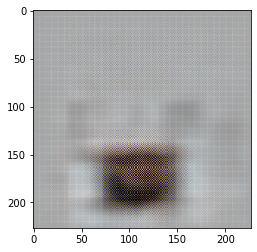

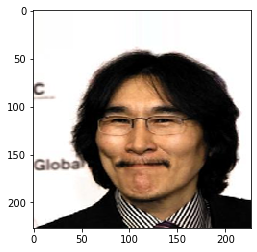

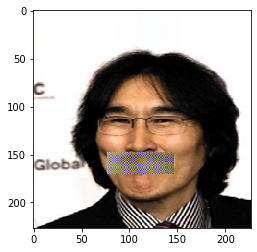

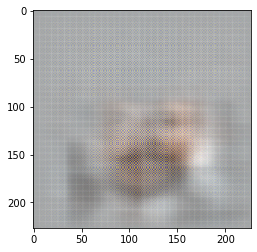

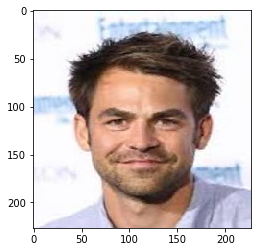

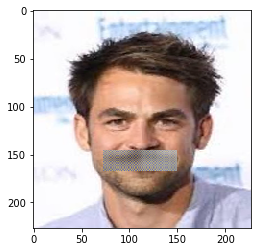

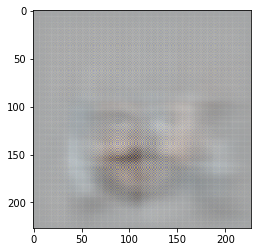

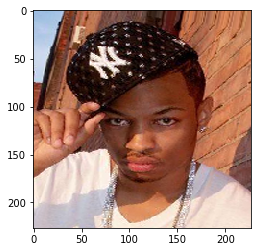

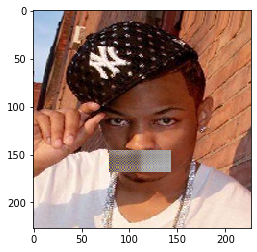

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


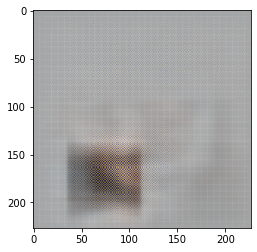

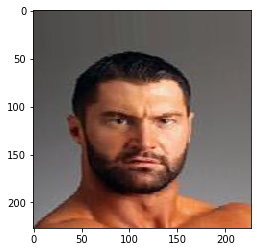

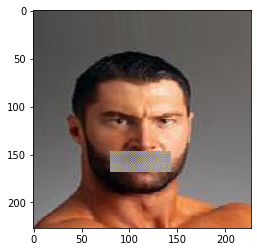

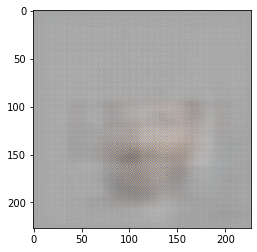

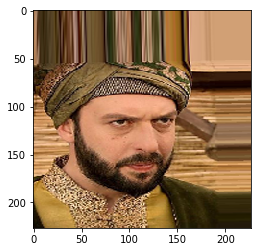

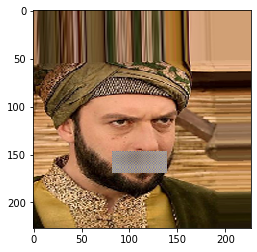

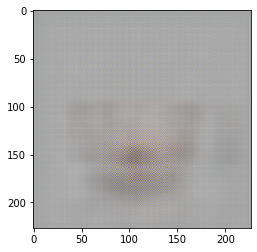

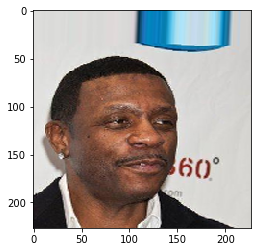

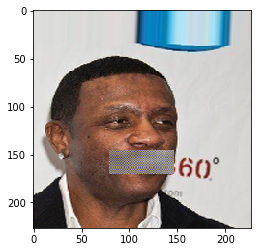

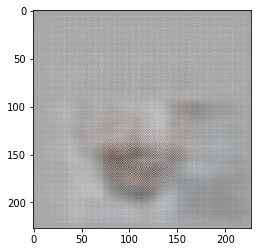

Epoch:7 Batches:1/1053 [D loss: 7.666619, acc: 50.00%] [G loss: 0.030241, mse: 0.014922]
Epoch:7 Batches:2/1053 [D loss: 7.666619, acc: 50.00%] [G loss: 0.036651, mse: 0.021339]
Epoch:7 Batches:3/1053 [D loss: 7.666619, acc: 50.00%] [G loss: 0.029703, mse: 0.014385]
Epoch:7 Batches:4/1053 [D loss: 7.666619, acc: 50.00%] [G loss: 0.027391, mse: 0.012070]
Epoch:7 Batches:5/1053 [D loss: 7.666619, acc: 50.00%] [G loss: 0.028273, mse: 0.012953]
Epoch:7 Batches:6/1053 [D loss: 7.666619, acc: 50.00%] [G loss: 0.027961, mse: 0.012641]
Epoch:7 Batches:7/1053 [D loss: 7.666619, acc: 50.00%] [G loss: 0.028000, mse: 0.012679]
Epoch:7 Batches:8/1053 [D loss: 7.666619, acc: 50.00%] [G loss: 0.027331, mse: 0.012010]
Epoch:7 Batches:9/1053 [D loss: 7.666619, acc: 50.00%] [G loss: 0.026711, mse: 0.011389]
Epoch:7 Batches:10/1053 [D loss: 7.666619, acc: 50.00%] [G loss: 0.026531, mse: 0.011209]
Epoch:7 Batches:11/1053 [D loss: 7.666619, acc: 50.00%] [G loss: 0.028886, mse: 0.013566]
Epoch:7 Batches:12/

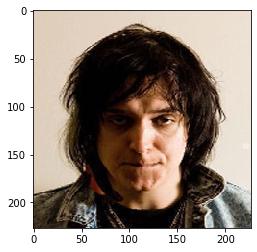

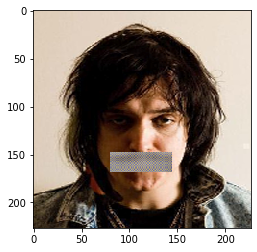

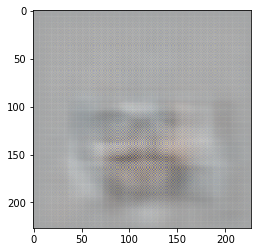

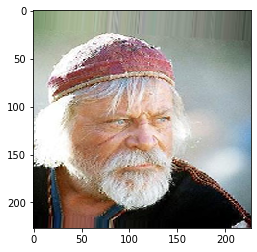

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


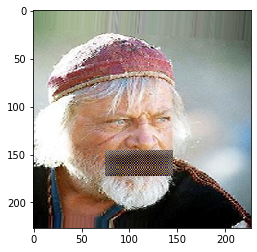

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


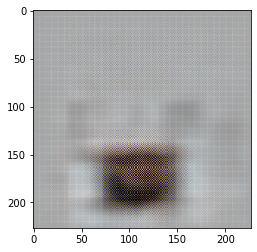

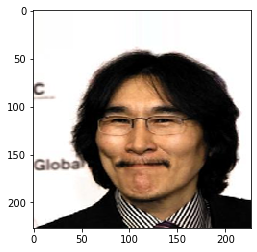

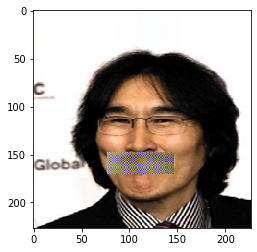

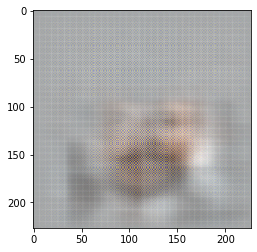

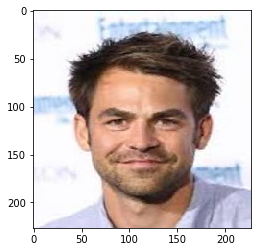

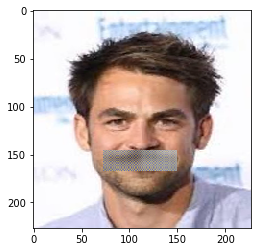

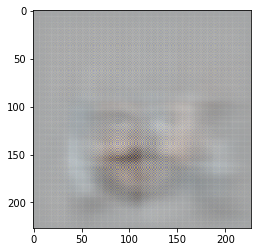

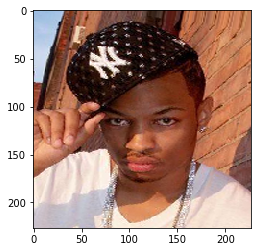

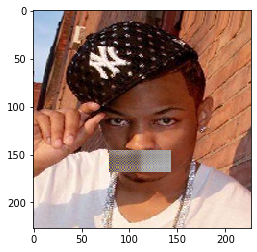

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


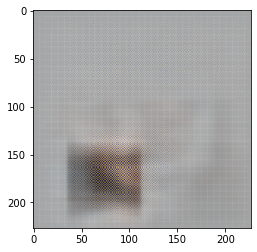

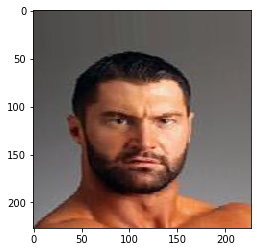

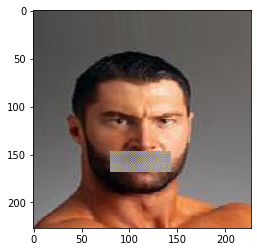

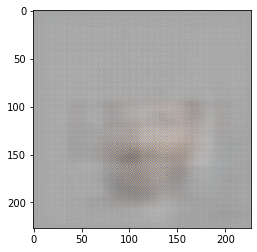

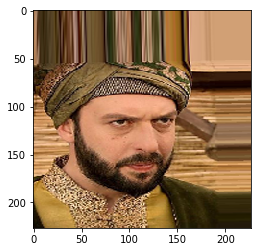

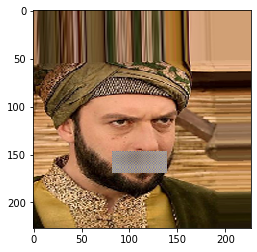

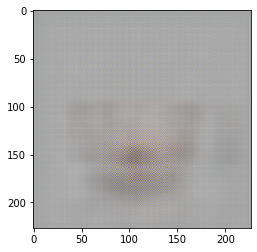

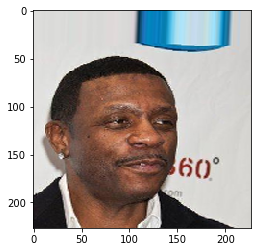

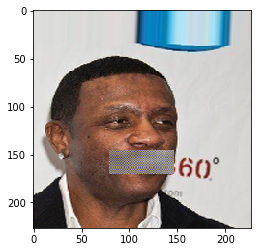

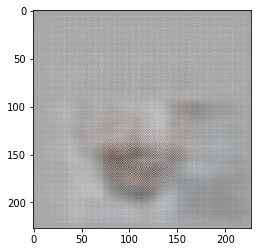

Epoch:8 Batches:1/1053 [D loss: 7.666619, acc: 50.00%] [G loss: 0.025664, mse: 0.010341]
Epoch:8 Batches:2/1053 [D loss: 7.666619, acc: 50.00%] [G loss: 0.028541, mse: 0.013221]
Epoch:8 Batches:3/1053 [D loss: 7.666619, acc: 50.00%] [G loss: 0.025501, mse: 0.010178]
Epoch:8 Batches:4/1053 [D loss: 7.666619, acc: 50.00%] [G loss: 0.025886, mse: 0.010563]
Epoch:8 Batches:5/1053 [D loss: 7.666619, acc: 50.00%] [G loss: 0.029574, mse: 0.014255]
Epoch:8 Batches:6/1053 [D loss: 7.666619, acc: 50.00%] [G loss: 0.030557, mse: 0.015239]
Epoch:8 Batches:7/1053 [D loss: 7.666619, acc: 50.00%] [G loss: 0.031382, mse: 0.016065]
Epoch:8 Batches:8/1053 [D loss: 7.666619, acc: 50.00%] [G loss: 0.032636, mse: 0.017321]
Epoch:8 Batches:9/1053 [D loss: 7.666619, acc: 50.00%] [G loss: 0.028727, mse: 0.013407]
Epoch:8 Batches:10/1053 [D loss: 7.666619, acc: 50.00%] [G loss: 0.031735, mse: 0.016418]
Epoch:8 Batches:11/1053 [D loss: 7.666619, acc: 50.00%] [G loss: 0.026514, mse: 0.011192]
Epoch:8 Batches:12/

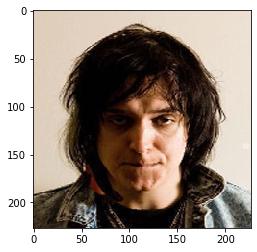

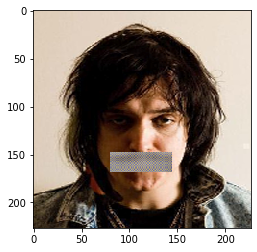

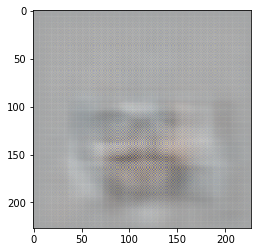

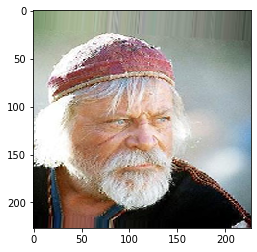

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


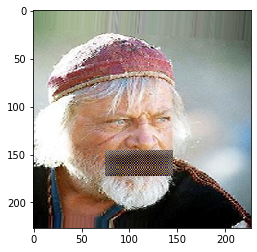

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


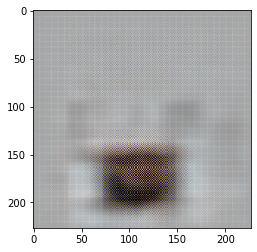

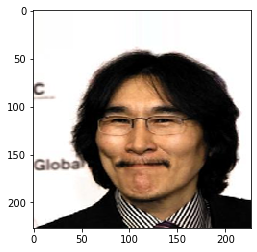

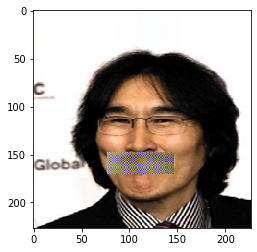

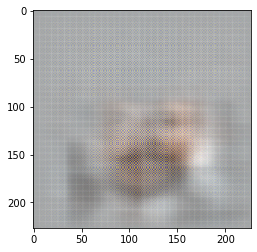

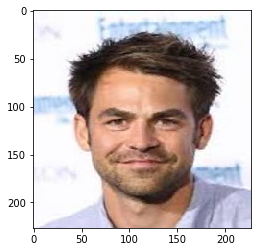

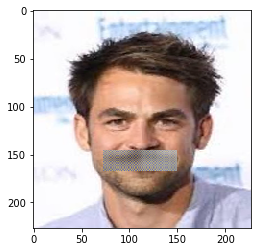

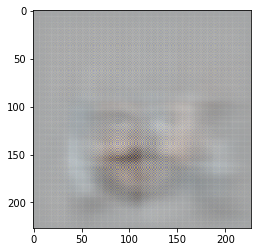

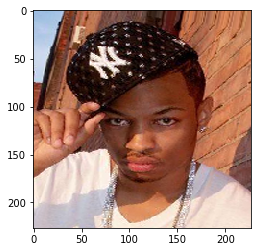

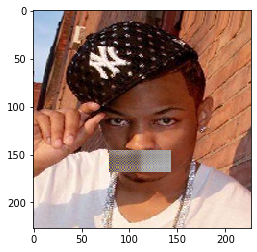

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


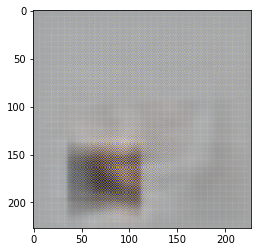

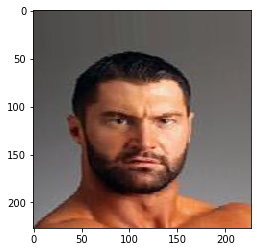

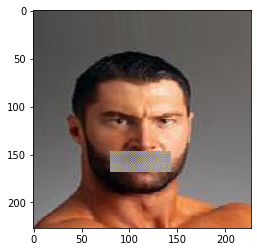

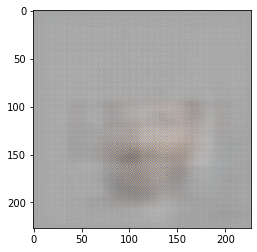

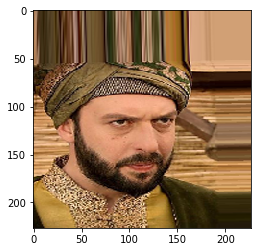

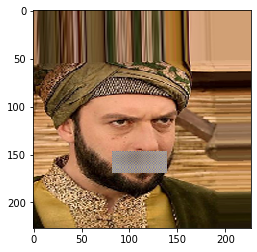

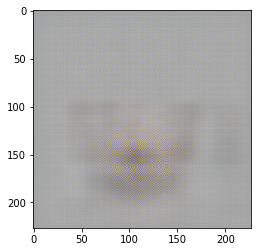

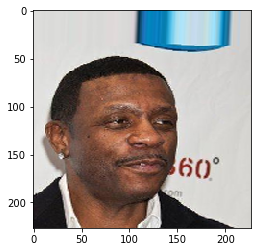

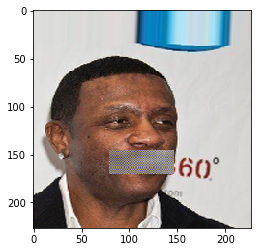

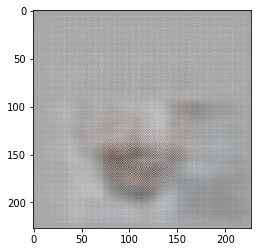

Epoch:9 Batches:1/1053 [D loss: 7.666619, acc: 50.00%] [G loss: 0.028281, mse: 0.012961]
Epoch:9 Batches:2/1053 [D loss: 7.666619, acc: 50.00%] [G loss: 0.029703, mse: 0.014384]
Epoch:9 Batches:3/1053 [D loss: 7.666619, acc: 50.00%] [G loss: 0.028412, mse: 0.013092]
Epoch:9 Batches:4/1053 [D loss: 7.666619, acc: 50.00%] [G loss: 0.026159, mse: 0.010836]
Epoch:9 Batches:5/1053 [D loss: 7.666619, acc: 50.00%] [G loss: 0.028284, mse: 0.012964]
Epoch:9 Batches:6/1053 [D loss: 7.666619, acc: 50.00%] [G loss: 0.032416, mse: 0.017100]
Epoch:9 Batches:7/1053 [D loss: 7.666619, acc: 50.00%] [G loss: 0.028273, mse: 0.012953]
Epoch:9 Batches:8/1053 [D loss: 7.666619, acc: 50.00%] [G loss: 0.027567, mse: 0.012246]
Epoch:9 Batches:9/1053 [D loss: 7.666619, acc: 50.00%] [G loss: 0.028807, mse: 0.013487]
Epoch:9 Batches:10/1053 [D loss: 7.666619, acc: 50.00%] [G loss: 0.029018, mse: 0.013698]
Epoch:9 Batches:11/1053 [D loss: 7.666619, acc: 50.00%] [G loss: 0.025627, mse: 0.010304]
Epoch:9 Batches:12/

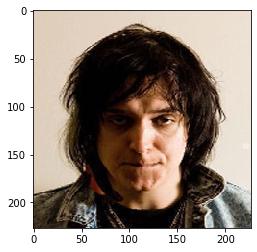

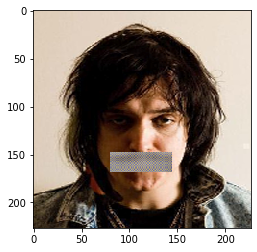

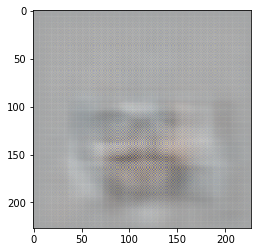

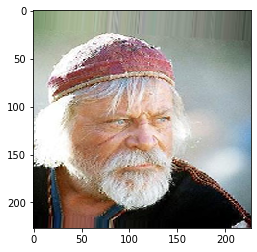

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


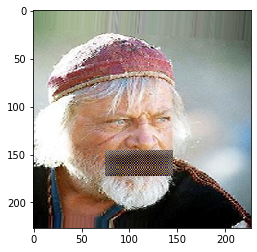

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


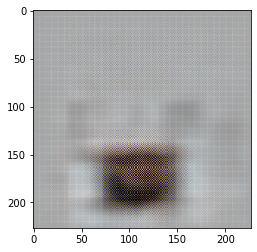

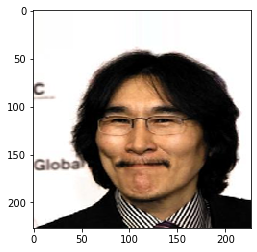

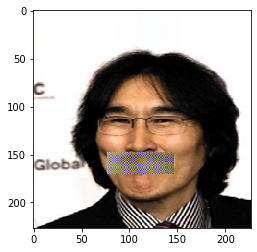

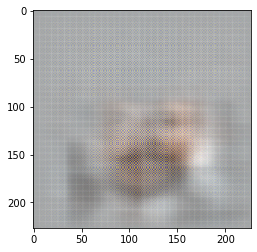

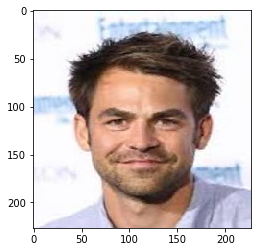

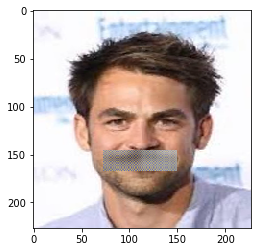

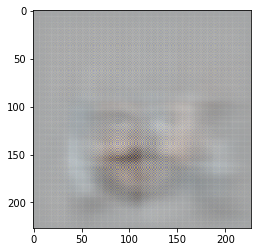

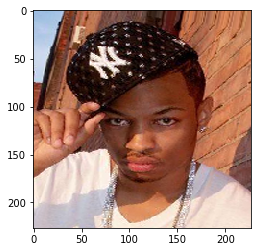

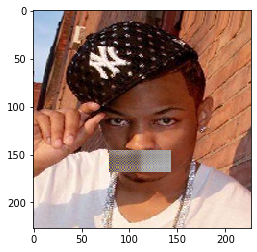

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


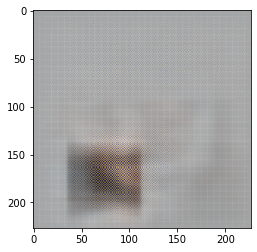

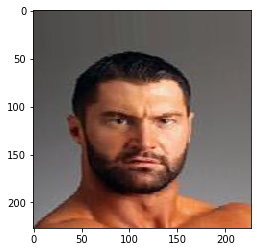

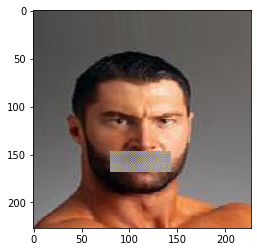

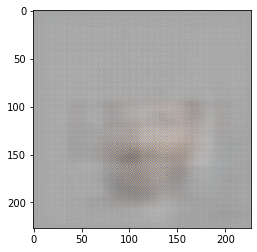

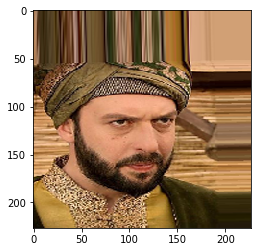

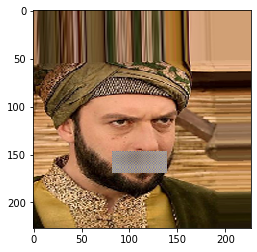

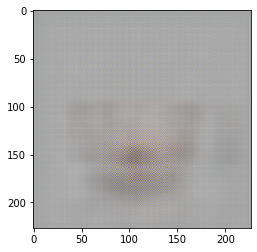

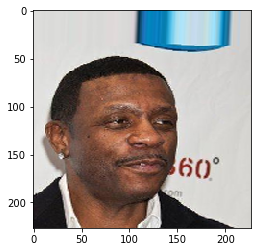

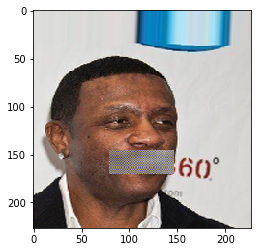

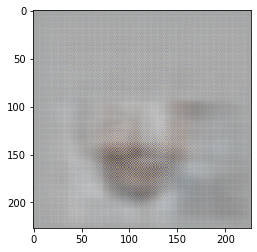

In [0]:
combined_model.summary()
epochs = 10
dataGenerator = DataStorage("./img_align_celeba_mustache_png", mode='train')
testDataGenerator = DataStorage("./test_images", batch_size=8, mode='test')
batches_in_epoch = dataGenerator.get_batches_count()
for epoch in range(epochs):
    for i in range(batches_in_epoch):
      a, masked_images, masked_parts_of_images , b, c = dataGenerator.get_next_batch()
      true_y_masks = [1 for e in masked_parts_of_images]

      gen_masked = Generator.predict([masked_images])
      false_y_masks = [0 for e in gen_masked]
       
      # Train Discriminator
      d_loss_real = Discriminator.train_on_batch([masked_parts_of_images], true_y_masks)
      d_loss_fake = Discriminator.train_on_batch([gen_masked], false_y_masks)
      d_loss = 0.5 * np.add(d_loss_real, d_loss_fake)

      # Train Generator
      g_loss = combined_model.train_on_batch([masked_images], [masked_parts_of_images, false_y_masks])

      print("Epoch:%d Batches:%d/%d [D loss: %f, acc: %.2f%%] [G loss: %f, mse: %f]" % (epoch, i+1,batches_in_epoch, d_loss[0], 100*d_loss[1], g_loss[0], g_loss[1]))

    images, masked_images, masked_parts_of_images , y_ranges, x_ranges = testDataGenerator.get_next_batch()
    gen_masks = model.predict([masked_images])
    # print(type(gen_masks))

    # print(y_ranges)
    # print(x_ranges)

    for i, img in enumerate(gen_masks):

        y_range = y_ranges[i]
        x_range = x_ranges[i]

        for y in range(y_range[0], y_range[1]):
            for x in range(x_range[0], x_range[1]):
                masked_images[i][y, x, :] = img[y, x, :]
        
        plt.imshow(images[i])
        plt.show()
        
        plt.imshow(masked_images[i]*0.5+0.5)
        plt.show()
        
        plt.imshow(img*0.5+0.5)
        plt.show()
        
        

In [0]:
Discriminator.save('dis1.h5')
Generator.save('gen1.h5')



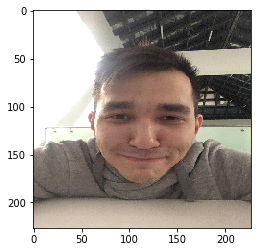

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


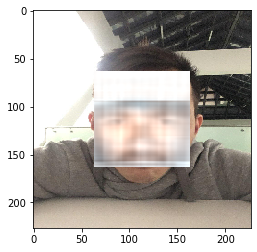

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


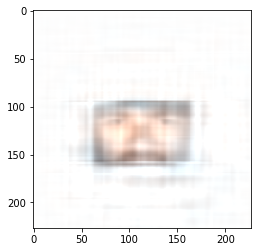

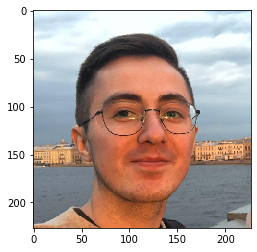

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


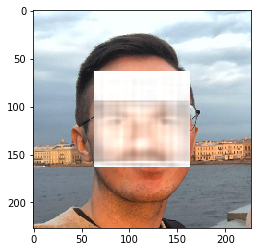

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


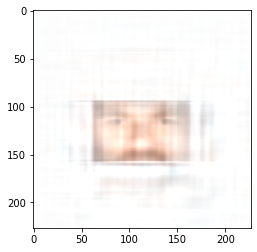

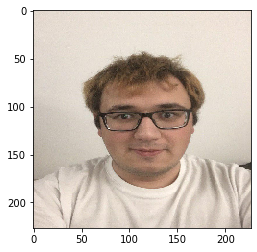

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


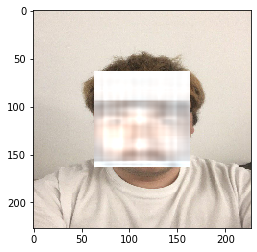

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


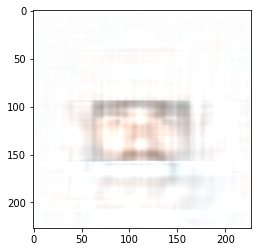

In [0]:
model = load_model('gen1.h5')
testDataGenerator = DataStorage("./test_images/test_our", batch_size=8, mode='center', mask_size=(100, 100))
images, masked_images, masked_parts_of_images , y_ranges, x_ranges = testDataGenerator.get_next_batch()
gen_masks = model.predict([masked_images])
# print(type(gen_masks))

# print(y_ranges)
# print(x_ranges)

for i, img in enumerate(gen_masks):

        y_range = y_ranges[i]
        x_range = x_ranges[i]

        for y in range(y_range[0], y_range[1]):
            for x in range(x_range[0], x_range[1]):
                masked_images[i][y, x, :] = img[y, x, :]
        
        plt.imshow(images[i])
        plt.show()
        
        plt.imshow(masked_images[i]*0.5+0.5)
        plt.show()
        
        plt.imshow(img*0.5+0.5)
        plt.show()
  